In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import string
import os
import glob
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib

## Select file

In [2]:
fto = '/storage/experiments/2023/0301_W62987/LABDOS01/'#W62987_2f5ddba8.csv'
fto = '/storage/experiments/2023/0301_SA/0312_W62988/'#W62987_2f5ddba8.csv'


## Load and plot data from LABDOS

In [3]:
print (fto)

l=[]
#l.extend(range(0,258))
#l.extend(range(0,260))
l.extend(range(0,505))

#df = pd.read_csv(fto+'/DATALOG.TXT', sep=',', header=None, names=l, comment='*', low_memory=False)
df = pd.read_csv(fto+'LABDOS01/0.TXT', sep=',', header=None, names=l, comment='*', low_memory=False)
df = df.reset_index(drop=True)
print('Loaded')

/storage/experiments/2023/0301_SA/0312_W62988/
Loaded


In [4]:
#SWITCH_ON_TIMES = ['2021-06-08 9:55', '2021-7-5 15:00', '2021-8-27 15:30']
SWITCH_ON_TIMES = ['2022-02-12 1:58']
SWITCH_ON_TIMES = ['2021-9-18 12:00', '2021-9-19 12:00', '2021-9-20 12:00', '2021-9-21 12:00', '2021-9-22 12:00', '2021-9-23 12:00', '2021-9-24 12:00', '2021-9-25 12:00', '2021-9-26 12:00', '2021-9-27 12:00', '2021-9-28 12:00', '2021-9-29 12:00', '2021-9-30 12:00']
SWITCH_ON_TIMES = ['2023-03-01 12:15']
SWITCH_ON_TIMES = ['2023-03-12 18:09']

df[2] = df[2].apply(pd.to_numeric, errors='coerce')

df['runtime'] = np.nan
df.loc[df[0]=='$HIST','seconds'] = df.loc[df[0]=='$HIST',2]
df.loc[df[0]=='$DOS','seconds'] = 0
df['runtime'] = df['seconds'].diff() * -1
rc = df.copy()
#rc = df.iloc[366870:378082,:].copy()
#rc = df.iloc[366683:378082,:].copy()
#rc = df.iloc[366714:378084,:].copy() 

run = 0
rc['run'] = np.nan

try:
    for x in rc.loc[rc[0]=='$DOS'].index:
        rc.loc[x,'run'] = SWITCH_ON_TIMES[run]
        run += 1
except:
    pass
rc['run'].fillna(method="ffill", inplace=True)

pd.set_option('display.max_rows', rc.shape[0]+1)
print(rc.loc[rc[0]=='$DOS'][[0,1,3, 'run', 'runtime']])
#print(rc.loc[rc[0]=='$AIRDOS'][[0,1, 'runtime']])
pd.set_option('display.max_rows', 10)

#!!!rc = rc.loc[rc[0]=='$HIST']
#rc = rc.iloc[949:]
rc = rc.iloc[3280:]

         0          1    3               run   runtime
0     $DOS  LABDOS01A  517  2023-03-12 18:09       NaN
905   $DOS  LABDOS01A  517  2023-03-12 18:09   7055.29
911   $DOS  LABDOS01A  517  2023-03-12 18:09     39.10
912   $DOS  LABDOS01A  517  2023-03-12 18:09     -0.00
917   $DOS  LABDOS01A  517  2023-03-12 18:09     31.32
922   $DOS  LABDOS01A  517  2023-03-12 18:09     31.34
924   $DOS  LABDOS01A  517  2023-03-12 18:09      7.98
929   $DOS  LABDOS01A  517  2023-03-12 18:09     31.34
948   $DOS  LABDOS01A  517  2023-03-12 18:09    140.39
3276  $DOS  LABDOS01A  517  2023-03-12 18:09  18120.60


In [5]:
rc[2] = pd.to_numeric(rc[2])
rc['time'] = pd.to_datetime(rc.run) + pd.to_timedelta(rc[2], unit='s')
rc.set_index(rc['time'], drop=False, inplace=True)

In [38]:
rc

,0,1,2,3,4,5,6,7,8,9,...,499,500,501,502,503,504,runtime,seconds,run,time
time,,,,,,,,,,,,,,,,,,,,,
2023-03-12 18:09:07.960,$HIST,0,7.96,478,732,19945,43274,1082.0,241.0,198.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.96,7.96,2023-03-12 18:09,2023-03-12 18:09:07.960
2023-03-12 18:09:15.770,$HIST,1,15.77,479,0,20546,43727,756.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.81,15.77,2023-03-12 18:09,2023-03-12 18:09:15.770
2023-03-12 18:09:23.560,$HIST,2,23.56,537,1,24326,40058,577.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.79,23.56,2023-03-12 18:09,2023-03-12 18:09:23.560
2023-03-12 18:09:31.350,$HIST,3,31.35,429,0,23464,41049,553.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.79,31.35,2023-03-12 18:09,2023-03-12 18:09:31.350
2023-03-12 18:09:39.150,$HIST,4,39.15,465,0,24094,40391,547.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.80,39.15,2023-03-12 18:09,2023-03-12 18:09:39.150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-12 23:41:20.710,$HIST,2554,19940.71,479,0,17237,46717,1080.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.81,19940.71,2023-03-12 18:09,2023-03-12 23:41:20.710
2023-03-12 23:41:28.520,$HIST,2555,19948.52,451,2,17323,46667,1062.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.81,19948.52,2023-03-12 18:09,2023-03-12 23:41:28.520
2023-03-12 23:41:36.360,$HIST,2556,19956.36,462,0,17745,46297,996.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-7.84,19956.36,2023-03-12 18:09,2023-03-12 23:41:36.360


# Load and plot telemetry data

In [6]:
#ftt = glob.iglob(fto+"/*/*.csv") # generator, search immediate subdirectories 
ftt = glob.iglob(fto+"/*.csv") # generator, search immediate subdirectories 
tele = pd.DataFrame()
for f in ftt:
    print(f)
    tele = pd.concat([tele, pd.read_csv(f)])
#tele

/storage/experiments/2023/0301_SA/0312_W62988/W62988_2f7fadd1.csv


Text(0, 0.5, 'Altitude a.s.l. [ft]')

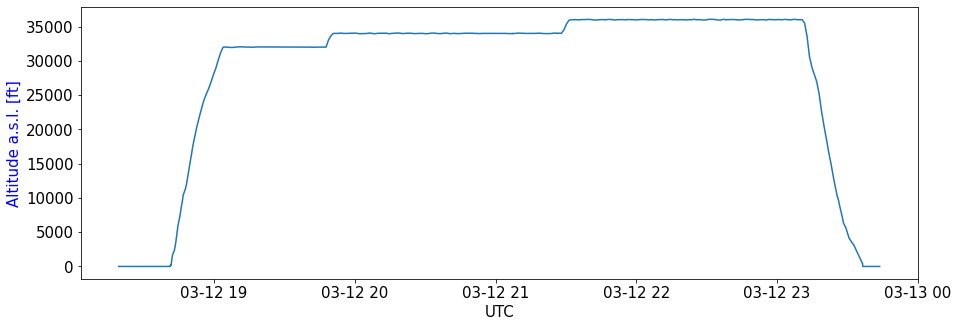

In [58]:
plt.figure(figsize=(15,5))

tele['time'] = pd.to_datetime(tele['UTC'], format='%Y-%m-%dT%H:%M:%SZ')
tele.set_index('time', inplace=True)
tele.sort_index(inplace=True)
plt.plot(tele['Altitude'])
plt.xlabel('UTC')
plt.ylabel('Altitude a.s.l. [ft]', color='blue')

In [67]:
tele

,Timestamp,UTC,Callsign,Position,Altitude,Speed,Direction
time,,,,,,,
2023-03-12 18:19:22,1678645162,2023-03-12T18:19:22Z,WZZ2988,"21.677376,39.141056",0,0,109
2023-03-12 18:21:42,1678645302,2023-03-12T18:21:42Z,WZZ2988,"21.677481,39.140827",0,2,81
2023-03-12 18:22:03,1678645323,2023-03-12T18:22:03Z,WZZ2988,"21.677458,39.140625",0,2,73
2023-03-12 18:22:26,1678645346,2023-03-12T18:22:26Z,WZZ2988,"21.677364,39.140423",0,2,95
2023-03-12 18:22:47,1678645367,2023-03-12T18:22:47Z,WZZ2988,"21.677328,39.140217",0,2,129
...,...,...,...,...,...,...,...
2023-03-12 23:42:53,1678664573,2023-03-12T23:42:53Z,WZZ2988,"48.120651,16.553862",0,4,25
2023-03-12 23:43:06,1678664586,2023-03-12T23:43:06Z,WZZ2988,"48.120884,16.553701",0,7,329
2023-03-12 23:43:12,1678664592,2023-03-12T23:43:12Z,WZZ2988,"48.12093,16.553461",0,5,300


# Combine AIRDOS and telemetry data

Text(0.5, 1.0, '/storage/experiments/2023/0301_SA/0312_W62988/')

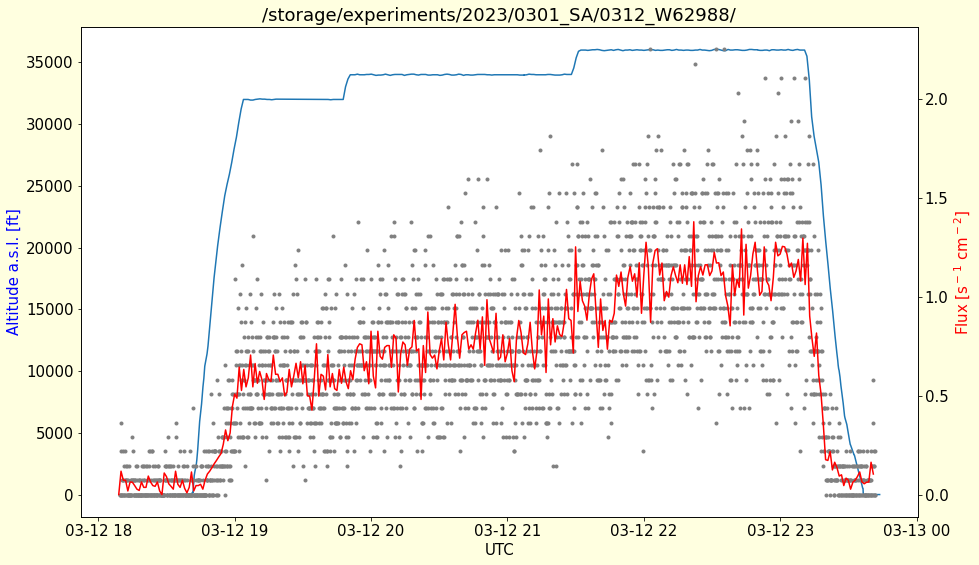

In [68]:
FIRST_CHANNEL = 8

plt.figure(figsize=(15,10), facecolor='lightyellow')
matplotlib.rcParams.update({'font.size': 15})


plt.plot(tele['Altitude'])
# Set limits of plot for magnification
#plt.xlim(pd.Timestamp('2019-09-03'),pd.Timestamp('2019-09-7'))
#plt.xlim(pd.Timestamp('2021-06-8'),pd.Timestamp('2021-06-12'))
#plt.xlim(pd.Timestamp('2021-10-8'),pd.Timestamp('2021-11-5')) # SWA last measurement
#plt.xlim(pd.Timestamp('2021-9-15'),pd.Timestamp('2021-9-28')) # SWB last measurement
plt.ylabel('Altitude a.s.l. [ft]', color='blue')
plt.xlabel('UTC')

#rc = rc.iloc[3286:]

plt.twinx()

rc['sum'] = rc[range(FIRST_CHANNEL,500)].sum(axis=1)/6.88/2
#rc['sum'] = rc[range(FIRST_CHANNEL,500)].sum(axis=1)

rc['sum'].plot(marker='.', linestyle='', color='gray')
rcc = rc.resample('1T').mean()
rcc['sum'].plot(color='red')
plt.ylabel('Flux [s$^-$$^1$ cm$^-$$^2$]', color='red')
plt.title(fto)

#plt.ylim([0,30]) 


0.034 0.016


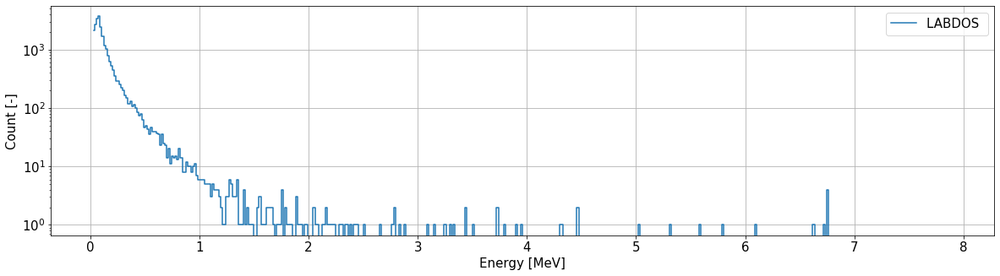

In [9]:
ener = rc.iloc[:,FIRST_CHANNEL:500].sum()

coef3 = np.array([0.,0.])
coef3[1] = 0.016
coef3[0] = 0.034
#coef3[1] = 0.03
#coef3[0] = 0.06

#(60 keV +-15 keV) + CH * 30 keV 
#0.034 MeV + ch * 0.016 MeV


print (coef3[0], coef3[1])

e3 = pd.DataFrame()
e3['1'] = ener
e3['i'] = ener.index
e3['x'] = (e3['i'].astype(float)-FIRST_CHANNEL) * coef3[1] + coef3[0]

plt.figure(figsize=(20,5))
matplotlib.rcParams.update({'font.size': 15})
plt.yscale('log')
#plt.xscale('log')

plt.plot(e3['x'], e3['1'] , label='LABDOS ', drawstyle='steps-mid')

plt.xlabel('Energy [MeV]')
plt.ylabel('Count [-]')
plt.grid()
plt.legend()
#plt.xticks(np.arange(0, 10, 1))
#plt.xlim(0,2)
#plt.vlines(0.511,1,1e4, color='red')

None

/tmp/ipykernel_11404/3006373546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rcc['sum'] = rcc[range(FIRST_CHANNEL,500)].sum(axis=1)/6.88/2


Text(0, 0.5, 'Flux [s$^-$$^1$ cm$^-$$^2$]')

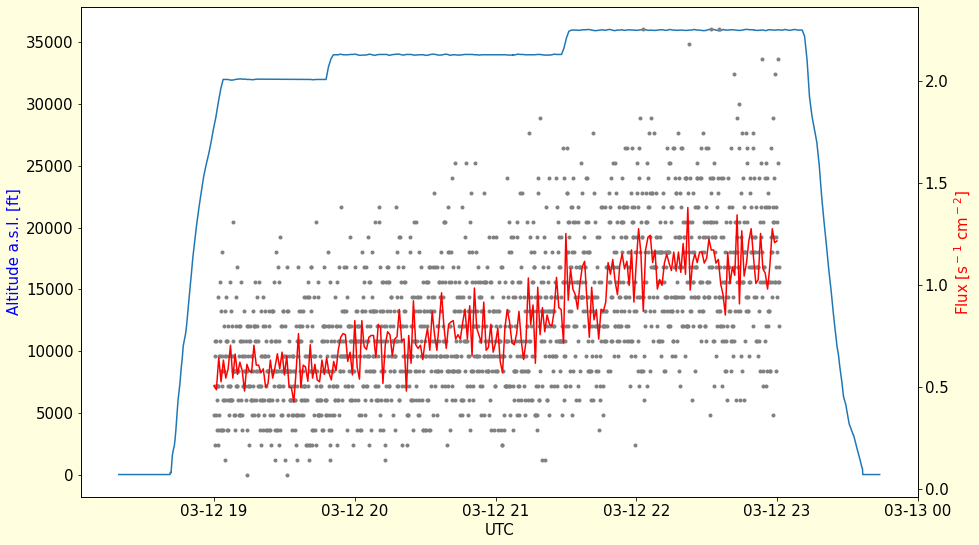

In [57]:
FIRST_CHANNEL = 8

plt.figure(figsize=(15,10), facecolor='lightyellow')
matplotlib.rcParams.update({'font.size': 15})


plt.plot(tele['Altitude'])
# Set limits of plot for magnification
#plt.xlim(pd.Timestamp('2019-09-03'),pd.Timestamp('2019-09-7'))
#plt.xlim(pd.Timestamp('2021-06-8'),pd.Timestamp('2021-06-12'))
#plt.xlim(pd.Timestamp('2021-10-8'),pd.Timestamp('2021-11-5')) # SWA last measurement
#plt.xlim(pd.Timestamp('2021-9-15'),pd.Timestamp('2021-9-28')) # SWB last measurement
plt.ylabel('Altitude a.s.l. [ft]', color='blue')
plt.xlabel('UTC')

rcc = rc.loc['2023-03-12 19:00':'2023-03-12 23:00']

plt.twinx()

rcc['sum'] = rcc[range(FIRST_CHANNEL,500)].sum(axis=1)/6.88/2
#rc['sum'] = rc[range(FIRST_CHANNEL,500)].sum(axis=1)

rcc['sum'].plot(marker='.', linestyle='', color='gray')
rccc = rcc.resample('1T').mean()
rccc['sum'].plot(color='red')
plt.ylabel('Flux [s$^-$$^1$ cm$^-$$^2$]', color='red')

#plt.ylim([0,30]) 


0.034 0.016


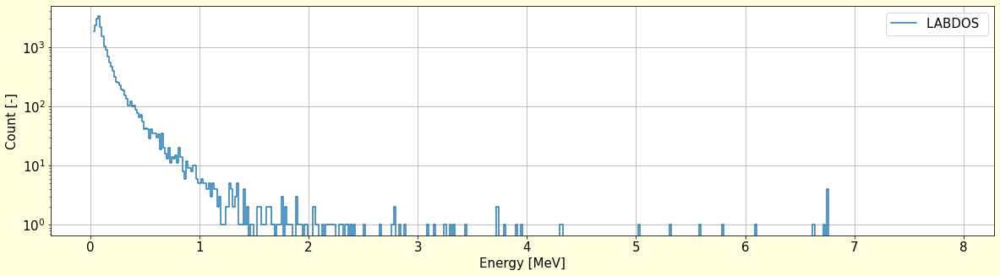

In [59]:
ener = rcc.iloc[:,FIRST_CHANNEL:500].sum()

coef3 = np.array([0.,0.])
coef3[1] = 0.016
coef3[0] = 0.034
#coef3[1] = 0.03
#coef3[0] = 0.06

#(60 keV +-15 keV) + CH * 30 keV 
#0.034 MeV + ch * 0.016 MeV


print (coef3[0], coef3[1])

e3 = pd.DataFrame()
e3['1'] = ener
e3['i'] = ener.index
e3['x'] = (e3['i'].astype(float)-FIRST_CHANNEL) * coef3[1] + coef3[0]

plt.figure(figsize=(20,5), facecolor='lightyellow')
matplotlib.rcParams.update({'font.size': 15})
plt.yscale('log')
#plt.xscale('log')

plt.plot(e3['x'], e3['1'] , label='LABDOS ', drawstyle='steps-mid')

plt.xlabel('Energy [MeV]')
plt.ylabel('Count [-]')
plt.grid()
plt.legend()
#plt.xticks(np.arange(0, 10, 1))
#plt.xlim(0,2)
#plt.vlines(0.511,1,1e4, color='red')

None

In [66]:
print('The first measurement', rcc.iloc[0,1])
print('The last measurement', rcc.iloc[-1,1])
measurement_duration = (int(rcc.iloc[-1,1]) - int(rcc.iloc[0,1])) * 6.88
flight_duration = rcc.iloc[-1,2] - rcc.iloc[0,2]
print('Begin', rcc.iloc[0,2], 's')
print('End', rcc.iloc[-1,2], 's')
print('Flight duration', round(flight_duration,2), 's')
print('Measurement duration', measurement_duration, 's')
deathtime_ratio = flight_duration / measurement_duration
print('Deathtime ratio', round(deathtime_ratio,2))

e3['total'] = e3['1']*e3['x']
depener = e3['total'].sum()*deathtime_ratio
print('Deposited Energy including deathtime', round(depener,2), 'MeV')
dose = (1e6*(1.602e-19 * depener*1e6)/0.1398e-3) 

# size of the chip (20 mm · 10 mm), 
# the thickness of the depletion layer (0.3 mm), 
# and the density of silicon (2.33 g cm^3)
# 0.1398e-3 kg
#dose = ((1e6 * (1.602e-19 * depener * 1e6)/0.1398e-3)/10.4) * 3600 * 2.71 # in uGy/h

print('Dose in silicon', round(dose,2), 'uGy')

The first measurement 392
The last measurement 2244
Begin 3064.7 s
End 17518.14 s
Flight duration 14453.44 s
Measurement duration 12741.76 s
Deathtime ratio 1.13
Deposited Energy including deathtime 3650.88 MeV
Dose in silicon 4.18 uGy


# Plot with plotly

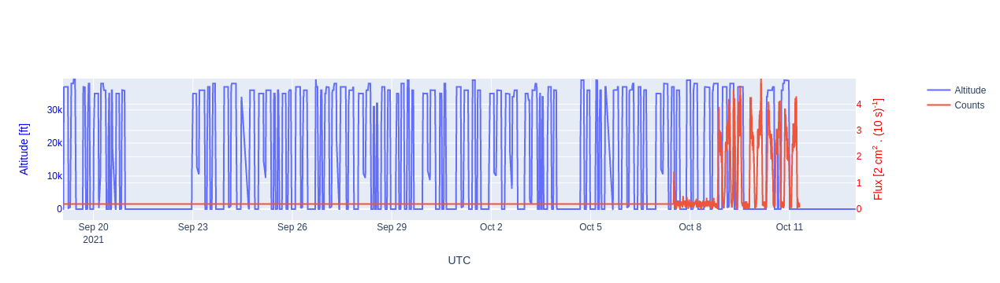

In [228]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=tele.index, y=tele.Altitude, name="Altitude"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=rc.index, y=rc['sum'], name="Counts"),
    secondary_y=True,
)



# Set x-axis title
fig.update_xaxes(title_text="UTC")

# Set y-axes titles
fig.update_yaxes(title_text="Altitude [ft]", color='blue', secondary_y=False)
fig.update_yaxes(title_text="Flux [2 cm<sup>2</sup> . (10 s)<sup>-1</sup>]", color='red', secondary_y=True)

fig.show()

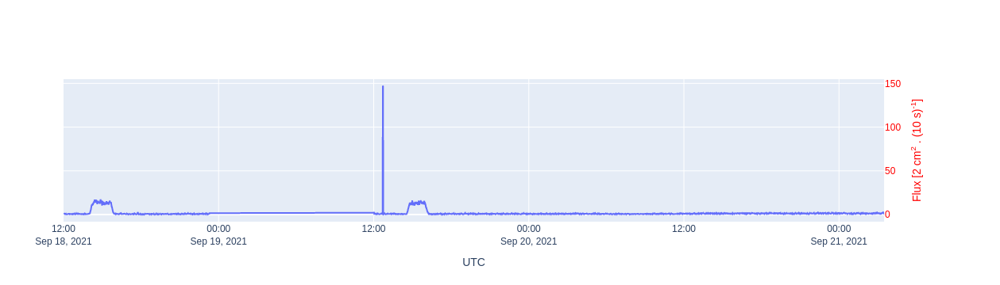

In [15]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=rc.index, y=rc['sum'], name="Counts"),
    secondary_y=True,
)

# Set x-axis title
fig.update_xaxes(title_text="UTC")

# Set y-axes titles
fig.update_yaxes(title_text="Flux [2 cm<sup>2</sup> . (10 s)<sup>-1</sup>]", color='red', secondary_y=True)

fig.show()

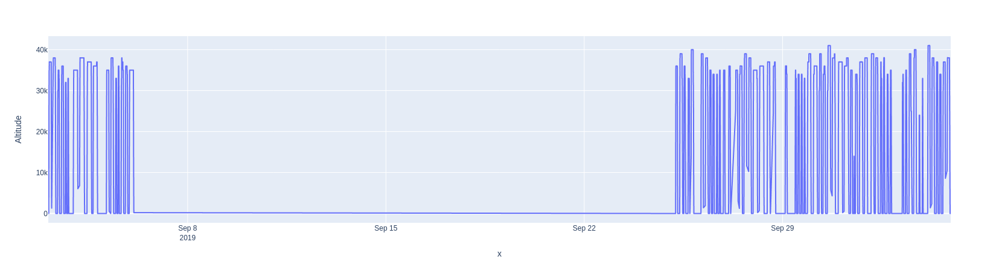

In [128]:
fig = px.line(tele, x=tele.index, y="Altitude")
fig.show()

In [179]:
import ipywidgets as widgets

In [189]:
fto = '/storage/aircraft/airdos/2019/TS/A016/200716-' #  File to Open
ftt = glob.iglob(fto+"/*/*.csv") # generator, search immediate subdirectories 
#tele = pd.DataFrame()
#for f in ftt:
    #print(f)
    #tele = pd.concat([tele, pd.read_csv(f)])


print(ftt)

ble = widgets.DatePicker(
    description='Pick a Date',
    disabled=False
)
display(ble)


<generator object _iglob at 0x7f529c5b1550>


DatePicker(value=None, description='Pick a Date')

In [192]:
print(ble.value)

2020-11-17


Text(0, 0.5, 'Counts per 10 seconds [-]')

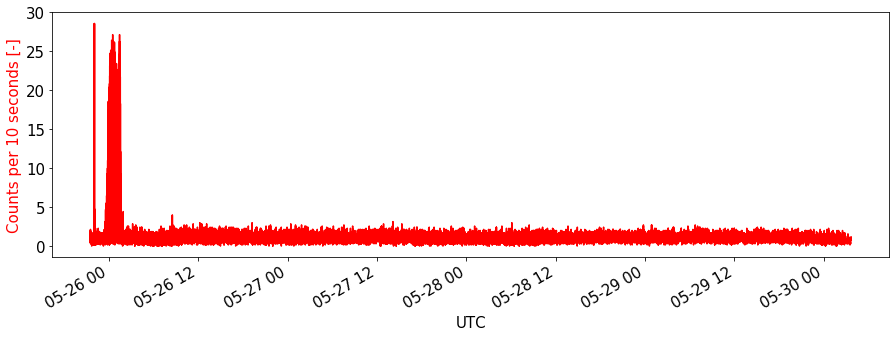

In [56]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})

#rc = df.loc[df[0]=='$CANDY']
rc.reset_index(drop=True, inplace=True)

rc = rc.apply(pd.to_numeric, errors='coerce')

#rc['sum'] = rc[range(7,255)].sum(axis=1)
rc['sum'] = rc[range(10,255)].sum(axis=1)

rc['time'] = pd.to_datetime(pd.to_datetime(SWITCH_ON_AIRDOS) + pd.to_timedelta(rc[2], unit='s'))
rc = rc.set_index(['time'])

WINDOW = 7
rc['sum'] = rc['sum'].rolling(WINDOW).mean()

rc['sum'].plot(color='r')
#plt.ylim([0,20])
plt.xlabel('UTC')
plt.ylabel('Counts per 10 seconds [-]', color='red')

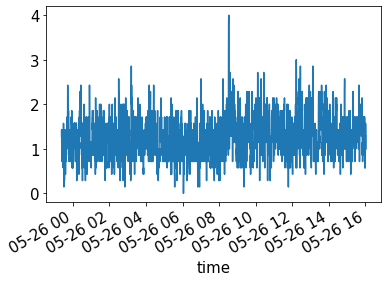

In [58]:
rc['sum'].iloc[:5000].plot()

In [59]:
df

,0,1,2,3,4,5,6,7,8,9,...,248,249,250,251,252,253,254,255,256,257
0,$CANDY,557,6655,24794,0,255.0,1.0,13217.0,7962.0,26.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,$CANDY,558,6705,24778,2,255.0,0.0,13392.0,7803.0,25.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,$CANDY,559,6717,24789,2,256.0,0.0,13170.0,8013.0,26.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,$CANDY,560,6728,24732,0,255.0,0.0,13526.0,7710.0,32.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,$CANDY,561,6740,24739,0,256.0,0.0,13543.0,7696.0,22.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75743,$CANDY,2673,42948,24801,1,255.0,0.0,13149.0,8018.0,31.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75744,$CANDY,2674,42964,24848,1,256.0,0.0,12778.0,8346.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75745,$CANDY,2675,42980,24756,2,255.0,0.0,13357.0,7866.0,19.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75746,$CANDY,2676,42996,24793,1,256.0,0.0,13194.0,7992.0,20.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [81]:
rc = df.iloc[73400:74100].copy()

In [29]:
rc['sum'] = rc[range(10,255)].sum(axis=1)


Text(0, 0.5, 'Counts per 10 seconds [-]')

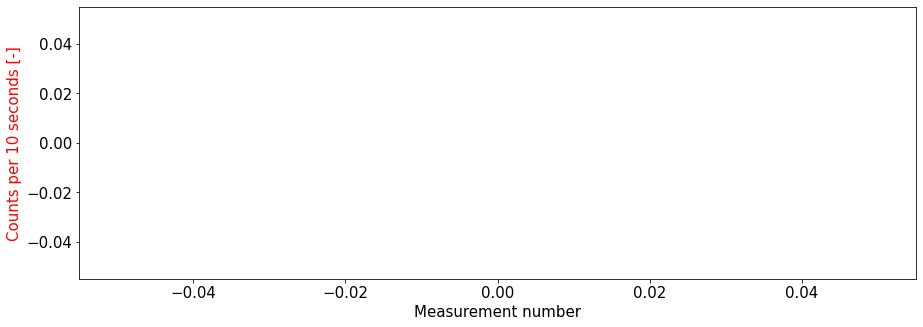

In [30]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})
rc['sum'].plot(marker='.',ls='')

WINDOW = 6
rc['mean'] = rc['sum'].rolling(WINDOW).mean()

rc['mean'].plot(color='r')
#plt.ylim([0,20])
plt.xlabel('Measurement number')
plt.ylabel('Counts per 10 seconds [-]', color='red')


Text(0, 0.5, 'Counts per 10 seconds [-]')

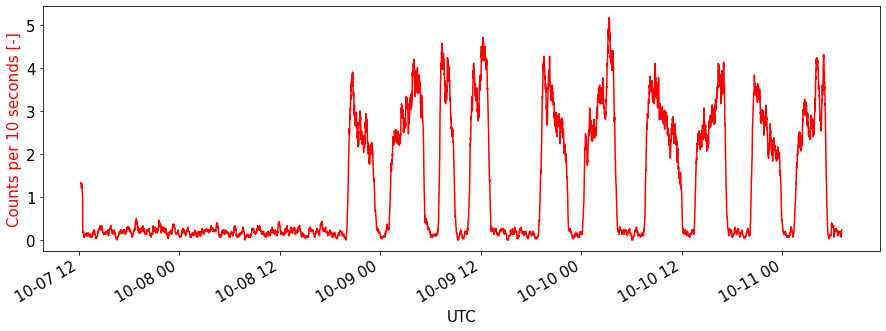

In [286]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})

#rc = df.loc[df[0]=='$CANDY']
rc.reset_index(drop=True, inplace=True)

#rc['sum'] = rc[range(7,255)].sum(axis=1)
rc['sum'] = rc[range(10,255)].sum(axis=1)

rc[2] = rc[2].apply(pd.to_numeric, errors='coerce')

rc['time'] = pd.to_datetime(pd.to_datetime(rc['run']) + pd.to_timedelta(rc[2], unit='s'))
rc.set_index('time', drop=False, inplace=True)

rc[9:258].apply(pd.to_numeric, errors='coerce')

rc = rc['2021-9-28':]


WINDOW = 30
rc['sum'] = rc['sum'].rolling(WINDOW).mean()
rc['diff'] = rc['sum'].diff()

rc['sum'].plot(color='r')
#plt.twinx()
#rc['sum'].loc[rc['sum']>3.2].plot(color='b')
#plt.ylim([0,20])
plt.xlabel('UTC')
plt.ylabel('Counts per 10 seconds [-]', color='red')

In [282]:
xc = rc['2021-9-28':]


WINDOW = 30
xc['sum'] = xc['sum'].rolling(WINDOW).mean()
xc['diff'] = xc['sum'].diff()
xc['flight'] = xc.loc[xc['sum']>3.2,'sum']
xc['flight'] = xc['flight'].fillna(0)

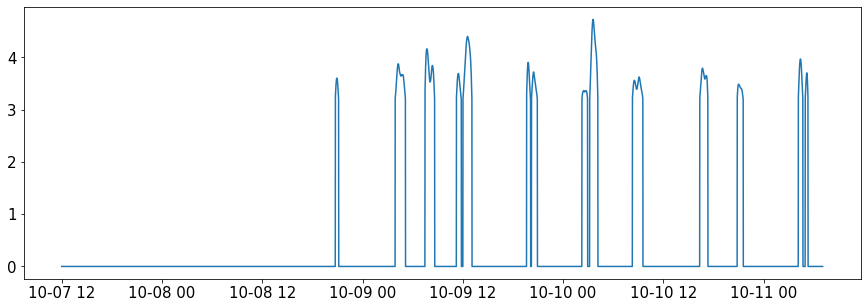

In [283]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})
plt.plot(xc['flight'])

In [284]:
zc = tele.join(xc)
zc['korelace'] = zc['Altitude']*zc['flight']
zc['korelace'].sum()

1587442.9777777777

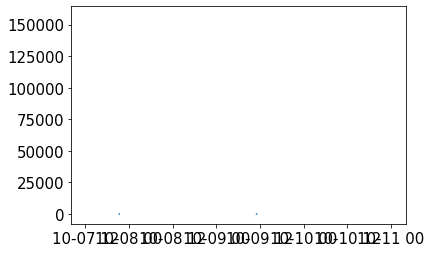

In [268]:
plt.plot(zc['korelace'])


,0,1,2,3,4,5,6,7,8,9,...,252,253,254,255,256,257,run,sum,time,diff
time,,,,,,,,,,,,,,,,,,,,,
2021-10-07 12:00:10,$CANDY,0,10,7064,13103.0,320.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25513.0,0.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:00:10,NaN
2021-10-07 12:00:43,$CANDY,1,43,6911,13274.0,283.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25532.0,0.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:00:43,NaN
2021-10-07 12:01:15,$CANDY,2,75,6679,13454.0,321.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25546.0,0.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:01:15,NaN
2021-10-07 12:01:47,$CANDY,3,107,6678,13428.0,339.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25552.0,3.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:01:47,NaN
2021-10-07 12:02:20,$CANDY,4,140,6757,13369.0,331.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,25541.0,2.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:02:20,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-11 07:01:49,$CANDY,10015,327709,7619,12662.0,218.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25498.0,3.0,256.0,2021-10-07 12:00,0.170778,2021-10-11 07:01:49,-0.000926
2021-10-11 07:02:22,$CANDY,10016,327742,7612,12692.0,222.0,2.0,0.0,0.0,1.0,...,0.0,0.0,0.0,25471.0,3.0,256.0,2021-10-07 12:00,0.169889,2021-10-11 07:02:22,-0.000889
2021-10-11 07:02:55,$CANDY,10017,327775,7671,12642.0,226.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25460.0,1.0,256.0,2021-10-07 12:00,0.169074,2021-10-11 07:02:55,-0.000815
